# Project: No Kangaroos in Austria

*The complete source code can be found under https://github.com/Declaminius/GeoGuessr-AI.*

In [1]:
import os
os.environ['USE_PYGEOS'] = '0'
import osmnx as ox
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, optimizers, losses

# Local configuration file
import config


plt.rcParams.update({"text.usetex": True})

train_ds_unbatched = config.train_ds.unbatch()
val_ds_unbatched = config.val_ds.unbatch()

train_ds32_unbatched = config.train_ds32.unbatch()
val_ds32_unbatched = config.val_ds32.unbatch()

Found 25062 files belonging to 2 classes.
Using 20050 files for training.
Using 5012 files for validation.
Instructions for updating:
Lambda fuctions will be no more assumed to be used in the statement where they are used, or at least in the same block. https://github.com/tensorflow/tensorflow/issues/56089
Found 25062 files belonging to 2 classes.
Using 20050 files for training.
Using 5012 files for validation.
Found 25062 files belonging to 2 classes.
Using 20050 files for training.
Using 5012 files for validation.


## Motivation

In the game GeoGuessr the player is dropped on a random location within Google Streetview with the goal to
determine his location as precisely as possible. In the simplest case, we are not allowed to move from our starting
position, pan around nor zoom in the initial image.

| ![Geoguessr Example](example.PNG) | 
|:--:| 
| *Example of a game of GeoGuessr* |

Hence the goal of this Machine Learning project is to map Street View images to location data. This setting
naturally allows for either regression, where we aim to predict the latitude and longitude of any given image, or
classification, if we ask to classify the images into pre-defined geographic regions, like countries or continents.
I want to focus on the classification task, where images are classified into the countries, where they are taken
in. A good starting point would then be to pick two distinct countries, like Austria and Australia to replace the
dogs vs cats dataset. Once a model works well for the binary classification task I will also try to extend it to a multinomial classification problem by adding more (and more difficult) countries.
 

## Generating the dataset

To obtain our dataset, we sample points from street network graphs obtained via the Overpass API and enter these locations in the Google Street View Static API. The API now checks whether there is an available street
view image within a fifty meter radius and if yes, returns one such image.


### Street network graphs

In order not to overwhelm the poor Overpass API, it was necessary to first split the queries for entire countries into queries of individual states, whose network size was more manageable. 
This approach worked well for Austrian states, which are relatively smaller than their Australian counterpart. 
For the bigger Australian states, however I had to resort to a different tool, where I instead downloaded the respective .osm-Files from a PlanetOSM mirror and used the handy command-line tool osmosis to filter out the relevant street network.

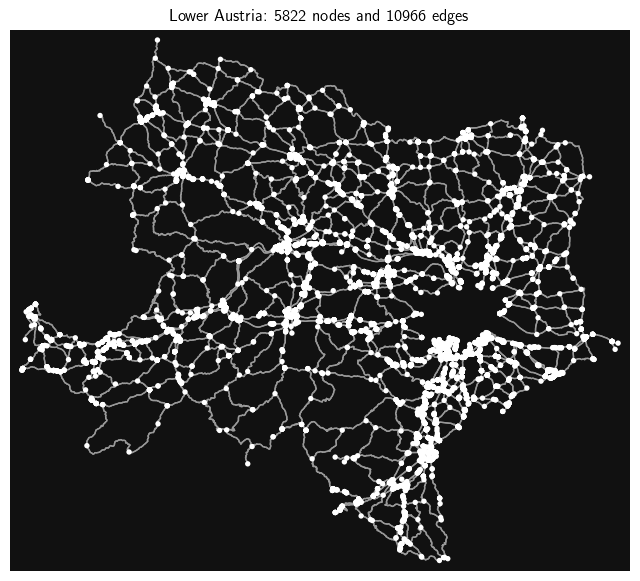

In [24]:
location = {'state': 'Lower Austria', 'country': 'Austria'}
G = ox.graph_from_place(location, network_type="drive", custom_filter = config.highway_filter)
basic_stats = ox.basic_stats(G)

fig, ax = ox.plot_graph(G, show=False, close=False)
ax.set_title(f"Lower Austria: {basic_stats['n']} nodes and {basic_stats['m']} edges")
plt.show()

### Generating images

Given a street network for a certain state, we can now use this graph to sample points along its edges and use
the obtained coordinates to request street view images at this location.

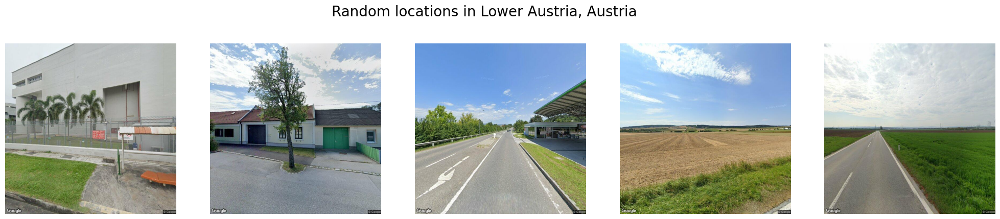

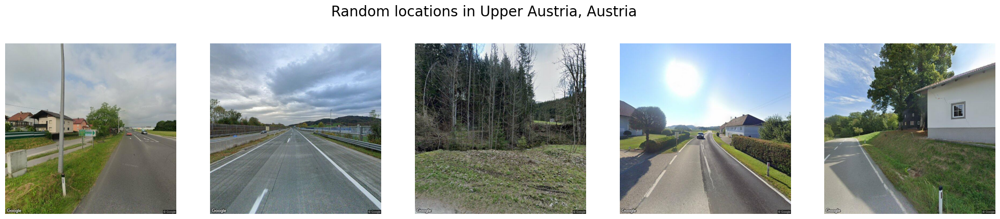

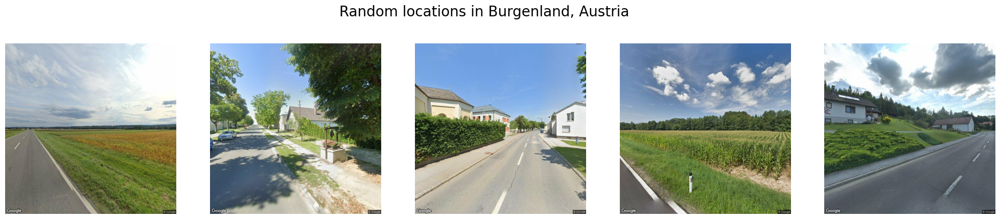

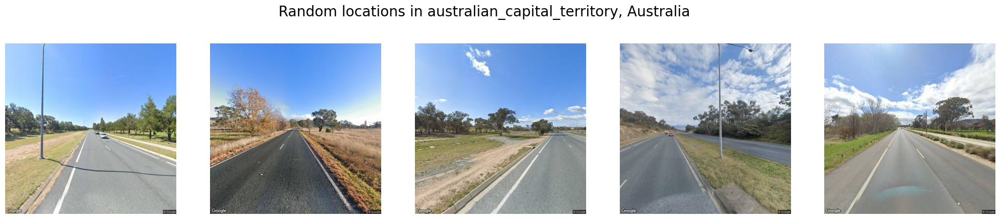

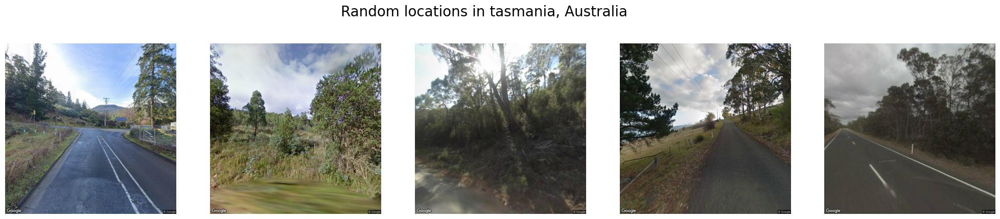

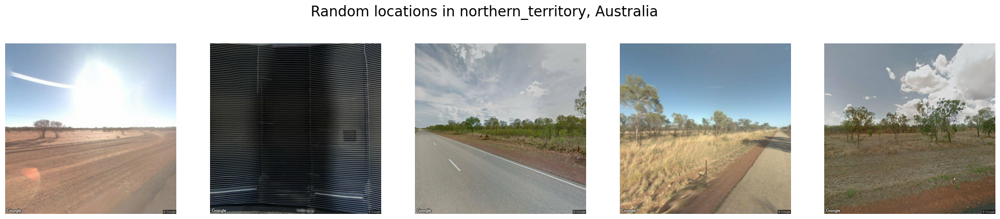

In [20]:
from street_view_images import StreetViewImagesForState

num_images = 5

for country in ("Austria", "Australia"):
    for i in range(3):
        state = config.states_dict[country][i]
        fig = plt.figure(figsize = (25,5))
        fig.suptitle(f"Random locations in {state}, {country}", size = 20)

        street_view_images_vienna = StreetViewImagesForState(state = state, country = country)
        sample_coordinates = street_view_images_vienna.generate_points(num_images)
        for i, location in enumerate(sample_coordinates):
            response = street_view_images_vienna.request_image(location)
            while response is None:
                location = street_view_images_vienna.generate_points(1)
                response = street_view_images_vienna.request_image(location)
            image = response[1]
            with open('image.jpg', 'wb') as file:
                file.write(image.content)
            image.close()
            plt.subplot(1,5,i+1)
            plt.axis('off')
            plt.imshow(mpimg.imread('image.jpg'))
        plt.show()


### Distribution of images

After a quick manual review of the image dataset, in which I removed a low-quality images (the main source of which where tunnel locations in Austria).
In the end I aimed for roughly 12.500 images per country to match the size of the Dogs vs. Cats dataset.
In the following we can see the distribution of locations across states.

In [14]:
for country in ("Austria", "Australia"):
    images_per_country = 0
    locations_per_country = 0
    for state in config.states_dict[country]:
        df = pd.read_csv(f"images/{country}/{state}/coordinates.csv", index_col= "i")
        images_per_country += sum(df['image_exists'])
        locations_per_country += len(df)
    
    print(f"{images_per_country} images out of {locations_per_country} locations in {country}.")


12504 images out of 13128 locations in Austria.
12560 images out of 12599 locations in Australia.


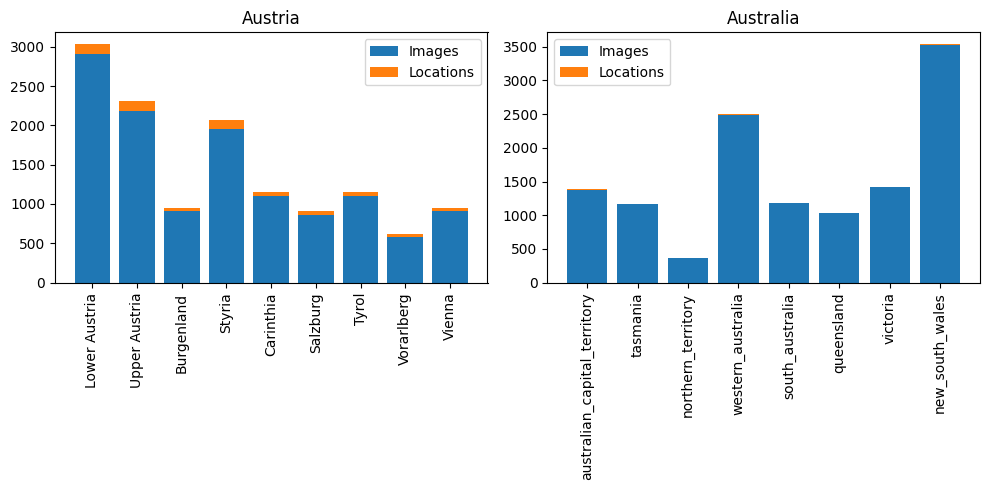

In [12]:
fig, axs = plt.subplots(ncols = 2, figsize = (10,5))
for (i,country) in enumerate(("Austria", "Australia")):
    images_per_state = []
    locations_per_state = []
    for state in config.states_dict[country]:
        df = pd.read_csv(f"images/{country}/{state}/coordinates.csv", index_col= "i")
        images_per_state.append(sum(df["image_exists"]))
        locations_per_state.append(len(df))

    axs[i].bar(config.states_dict[country], images_per_state, label = "Images")
    axs[i].bar(config.states_dict[country], np.array(locations_per_state) - np.array(images_per_state), bottom=images_per_state, label = "Locations")
    axs[i].set_title(country)
    axs[i].tick_params('x', labelrotation=90)
    axs[i].legend()
plt.tight_layout()
plt.show()

### Preprocessing

In [ ]:
from tensorflow.data import AUTOTUNE

image_dir = "images"
batch_size = 32

def standardize_image(image, label):
    mean = tf.reduce_mean(image)
    std = tf.math.reduce_std(image)
    standardized_image = tf.map_fn(lambda x: (x - mean)/std, image)
    return (standardized_image, label)

def create_standardized_dataset(image_size):
    train_ds, val_ds = keras.utils.image_dataset_from_directory(
        image_dir,
        validation_split=0.2,
        labels="inferred",
        class_names=["Austria","Australia"],
        subset="both",
        seed = 0,
        batch_size = batch_size,
        crop_to_aspect_ratio=True,
        image_size=(image_size, image_size))
    
    train_ds = train_ds.map(standardize_image)
    val_ds = val_ds.map(standardize_image)

    train_ds = train_ds.prefetch(buffer_size = AUTOTUNE)
    val_ds = val_ds.prefetch(buffer_size = AUTOTUNE)

    return train_ds, val_ds

## Ridge classificiation

The first simple model we try to train on our dataset is a Ridge regressor.

Ridge regression is an extension to least squares which introduces an additional regularization parameter $\lambda \geq 0$. As such, the loss is given by:

\begin{align*}
    J_{\mathrm{Ridge}}(\textbf{w}) = \|X\textbf{w} - y\|^2 + \lambda \|\textbf{w}\|^2.
\end{align*}
The regularization parameter $\lambda$ is tasked to control the *generalization* to unseen data.

We preprocess our image data by rescaling it to the interval [0,1].


Training data:
500 out of 500 correctly classified.
Validation data:
277 out of 500 correctly classified.
Training data:
500 out of 500 correctly classified.
Validation data:
259 out of 500 correctly classified.
Training data:
500 out of 500 correctly classified.
Validation data:
236 out of 500 correctly classified.
Training data:
500 out of 500 correctly classified.
Validation data:
249 out of 500 correctly classified.
Training data:
500 out of 500 correctly classified.
Validation data:
256 out of 500 correctly classified.


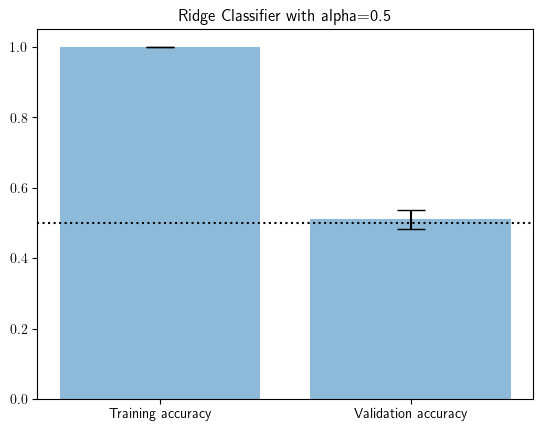

In [9]:
from sklearn import linear_model
from ridge_classifier import evaluate_regressor, plot_accuracy

alpha = 0.5
sample_size = 500
ridge_classifier = linear_model.RidgeClassifier(alpha = alpha)
ridge_accuracy_array = np.empty((5,2))
for i in range(5):
    train_accuracy, val_accuracy = evaluate_regressor(ridge_classifier, sample_size, train_ds_unbatched, val_ds_unbatched)
    ridge_accuracy_array[i] = np.array([train_accuracy, val_accuracy])
plot_accuracy(ridge_accuracy_array, f'Ridge Classifier with {alpha=}')

This is a clear example of overfitting. The reason for that becomes apparent when we compare the size of the input with our sample size. Since each image consists of three channels on a grid of size 256x256, we have circa 200.000 input features compared to only 500 samples. Putting it that way makes it pretty obvious that the task of finding a separating plane in the training set should not be very hard, in fact it can be done perfectly. However, due to the sheer mulitude of possible hyperplanes, it is unlikely that this classification generalizes well to unseen data.
However, to make sure we do some additional cross-validation for different values of alpha:

In [3]:
from ridge_classifier import sample_data
sample_size = 500

ridge_regressor = linear_model.RidgeClassifierCV(alphas = [0.1,1,10])
train_images, train_labels = sample_data(train_ds_unbatched, sample_size)
val_images, val_labels = sample_data(val_ds_unbatched, sample_size)
    
# Fit the regressor
ridge_regressor.fit(train_images, train_labels)
print(ridge_regressor.alpha_, ridge_regressor.best_score_)
print(ridge_regressor.score(train_images, train_labels))
print(ridge_regressor.score(val_images, val_labels))

10.0 -1.2237007160532294
1.0
0.454


To adapt to this problem, let's try again with downscaled images in 32x32 resolution and an increased sample size of 5.000 images.

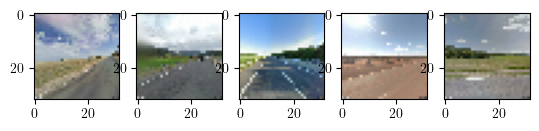

Training data:
4168 out of 5000 correctly classified.
Validation data:
2483 out of 5000 correctly classified.
Training data:
4268 out of 5000 correctly classified.
Validation data:
2334 out of 5000 correctly classified.
Training data:
4190 out of 5000 correctly classified.
Validation data:
2470 out of 5000 correctly classified.
Training data:
4157 out of 5000 correctly classified.
Validation data:
2489 out of 5000 correctly classified.
Training data:
4214 out of 5000 correctly classified.
Validation data:
2586 out of 5000 correctly classified.


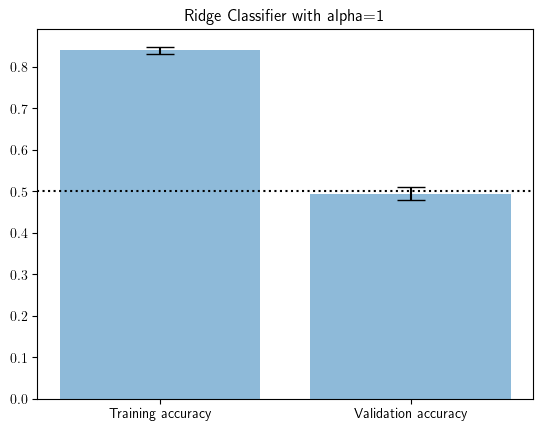

In [8]:
from sklearn import linear_model
from ridge_classifier import evaluate_regressor, plot_accuracy

i = 1
for image, label in train_ds_unbatched.take(5):
    plt.subplot(1,5,i)
    plt.imshow(image.numpy().astype(np.uint8))
    i += 1

plt.show()

alpha = 1
sample_size = 5000
ridge_classifier = linear_model.RidgeClassifier(alpha = alpha)
ridge_accuracy_array = np.empty((5,2))
for i in range(5):
    train_accuracy, val_accuracy = evaluate_regressor(ridge_classifier, sample_size, train_ds32_unbatched, val_ds32_unbatched)
    ridge_accuracy_array[i] = np.array([train_accuracy, val_accuracy])
plot_accuracy(ridge_accuracy_array, f'Ridge Classifier with {alpha=}')

After reducing the size of the input drastically, we can observe that we no longer come close to achieving a perfect score on the training dataset. However, this change produced no statistically significant improvement of the score on the validation dataset. In fact, we are even worse off than if we would just guess at random.

## Logistic Regression

I also tried to train this regressor on the 256x256 resolution dataset, however it did not converge within 500 iterations and showed no more promising results than on the smaller 32x32 dataset.

Training data:
500 out of 500 correctly classified.
Validation data:
256 out of 500 correctly classified.
Training data:
500 out of 500 correctly classified.
Validation data:
257 out of 500 correctly classified.
Training data:
500 out of 500 correctly classified.
Validation data:
269 out of 500 correctly classified.
Training data:
500 out of 500 correctly classified.
Validation data:
251 out of 500 correctly classified.
Training data:
499 out of 500 correctly classified.
Validation data:
260 out of 500 correctly classified.


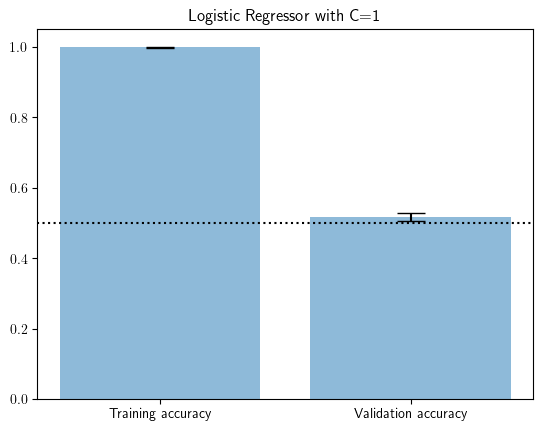

In [11]:
C = 1
max_iter = 500
sample_size = 500
logistic_regressor = linear_model.LogisticRegression(C = C, max_iter = max_iter)
logistic_accuracy_array = np.empty((5,2))
for i in range(5):
    train_accuracy, val_accuracy = evaluate_regressor(logistic_regressor, sample_size, train_ds32_unbatched, val_ds32_unbatched)
    logistic_accuracy_array[i] = np.array([train_accuracy, val_accuracy])

plot_accuracy(logistic_accuracy_array, f'Logistic Regressor with {C=}')

## Support vector machines

### Linear Kernel

Training data:
250 out of 250 correctly classified.
Validation data:
131 out of 250 correctly classified.
Training data:
250 out of 250 correctly classified.
Validation data:
113 out of 250 correctly classified.
Training data:
250 out of 250 correctly classified.
Validation data:
147 out of 250 correctly classified.
Training data:
250 out of 250 correctly classified.
Validation data:
126 out of 250 correctly classified.
Training data:
250 out of 250 correctly classified.
Validation data:
119 out of 250 correctly classified.


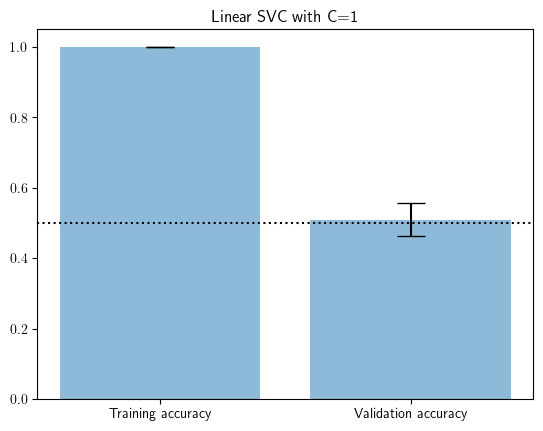

In [13]:
from sklearn import svm

sample_size = 250
svc_linear = svm.SVC(kernel = "linear")
svc_linear_accuracy_array = np.empty((5,2))
for i in range(5):
    train_accuracy, val_accuracy = evaluate_regressor(svc_linear, sample_size, train_ds_unbatched, val_ds_unbatched)
    svc_linear_accuracy_array[i] = np.array([train_accuracy, val_accuracy])
plot_accuracy(svc_linear_accuracy_array, f'Linear SVC with {C=}')
plt.show()

### Rbf kernel

Training data:
257 out of 500 correctly classified.
Validation data:
255 out of 500 correctly classified.
Training data:
253 out of 500 correctly classified.
Validation data:
255 out of 500 correctly classified.
Training data:
258 out of 500 correctly classified.
Validation data:
245 out of 500 correctly classified.
Training data:
251 out of 500 correctly classified.
Validation data:
255 out of 500 correctly classified.
Training data:
257 out of 500 correctly classified.
Validation data:
255 out of 500 correctly classified.
Training data:
257 out of 500 correctly classified.
Validation data:
255 out of 500 correctly classified.
Training data:
356 out of 500 correctly classified.
Validation data:
230 out of 500 correctly classified.
Training data:
317 out of 500 correctly classified.
Validation data:
259 out of 500 correctly classified.
Training data:
259 out of 500 correctly classified.
Validation data:
255 out of 500 correctly classified.
Training data:
252 out of 500 correctly classi

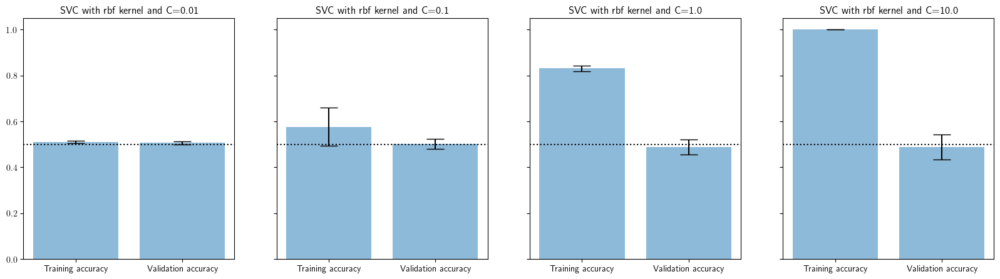

In [6]:
from sklearn import svm
from ridge_classifier import evaluate_regressor, plot_accuracy

sample_size = 500
C_array = [1e-2,1e-1,1e+0,1e+1]

fig, axs = plt.subplots(nrows = 1, ncols = 4, figsize = (20,5), sharey = True)

for i, C in enumerate(C_array):
    svc_rbf = svm.SVC(C = C, kernel = "rbf")
    svc_rbf_accuracy_array = np.empty((5,2))
    for j in range(5):
        train_accuracy, val_accuracy = evaluate_regressor(svc_rbf, sample_size, train_ds32_unbatched, val_ds32_unbatched)
        svc_rbf_accuracy_array[j] = np.array([train_accuracy, val_accuracy])
    plt.sca(axs.flatten()[i])
    plot_accuracy(svc_rbf_accuracy_array, f'SVC with rbf kernel and {C=}')

plt.show()

Since the strength of the reguralization scales inversely proportional to C, smaller values of C leads to a reduced accuracy on the training dataset. However, none of the above choices for C generalize well to unseen data.

## Neural network

### Training the model

In [3]:
model = keras.Sequential(
    [
    layers.Conv2D(32, (3,3), input_shape = (256,256,3), activation = "relu", padding="same"),
    layers.MaxPooling2D((2,2), padding="same"),
    layers.Conv2D(32, (3,3), activation = "relu", padding="same"),
    layers.MaxPooling2D((2,2), padding="same"),
    layers.Conv2D(32, (3,3), activation = "relu", padding="same"),
    layers.MaxPooling2D((2,2), padding="same"),
    layers.Conv2D(32, (3,3), activation = "relu", padding="same"),
    layers.MaxPooling2D((2,2), padding="same"),
    layers.Conv2D(32, (3,3), activation = "relu", padding="same"),
    layers.MaxPooling2D((2,2), padding="same"),
    layers.Conv2D(32, (3,3), activation = "relu", padding="same"),
    layers.MaxPooling2D((2,2), padding="same"),
    layers.Flatten(),
    layers.Dense(100),
    layers.Dropout(0.1),
    layers.Dense(1, activation = 'sigmoid'),
    ])

optimizer = optimizers.Adam(learning_rate = 0.001)

model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics = ["accuracy"])
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 256, 256, 32)      896       
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 128, 128, 32)     0         
 2D)                                                             
                                                                 
 conv2d_7 (Conv2D)           (None, 128, 128, 32)      9248      
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 64, 64, 32)       0         
 2D)                                                             
                                                                 
 conv2d_8 (Conv2D)           (None, 64, 64, 32)        9248      
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 32, 32, 32)      

In [ ]:
history = model.fit(config.train_ds, epochs = 20, validation_data = config.val_ds)

Epoch 1/20
627/627 [==============================] - 510s 811ms/step - loss: 0.3680 - accuracy: 0.8300 - val_loss: 0.3272 - val_accuracy: 0.8733
Epoch 2/20
627/627 [==============================] - 504s 803ms/step - loss: 0.2524 - accuracy: 0.8956 - val_loss: 0.2311 - val_accuracy: 0.9044
Epoch 3/20
627/627 [==============================] - 503s 800ms/step - loss: 0.2093 - accuracy: 0.9158 - val_loss: 0.1807 - val_accuracy: 0.9278
Epoch 4/20
627/627 [==============================] - 511s 814ms/step - loss: 0.1740 - accuracy: 0.9301 - val_loss: 0.1580 - val_accuracy: 0.9385
Epoch 5/20
627/627 [==============================] - 501s 798ms/step - loss: 0.1499 - accuracy: 0.9412 - val_loss: 0.2128 - val_accuracy: 0.9226
Epoch 6/20
627/627 [==============================] - 504s 791ms/step - loss: 0.1332 - accuracy: 0.9491 - val_loss: 0.1784 - val_accuracy: 0.9356
Epoch 7/20
627/627 [==============================] - 516s 821ms/step - loss: 0.1185 - accuracy: 0.9544 - val_loss: 0.1699 -

In [ ]:
model.save('neural_net')

INFO:tensorflow:Assets written to: neural_net/assets


INFO:tensorflow:Assets written to: neural_net/assets


### Evaluation

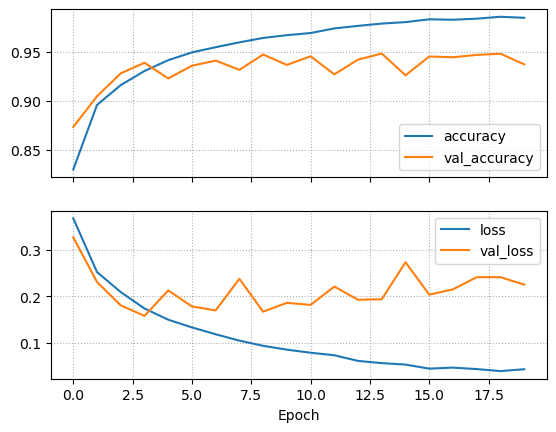

In [ ]:
fig, axs = plt.subplots(2,1, sharex = True)
keys = [["accuracy", "val_accuracy"], ["loss", "val_loss"]]
for (ax, k) in zip(axs,keys):
    for key in k:
        ax.plot(history.history[key], label = key)
    
    ax.legend()
    ax.grid(linestyle = "dotted")

plt.xlabel("Epoch")
plt.show()

In [ ]:
predictions = model.predict(config.val_ds).reshape((5012,))
labels = np.array([x for x in config.val_ds.unbatch().map(lambda x,y: y)])

confidence = 1 - np.abs(predictions - np.round(predictions))
print(f"Average confidence: {100*np.mean(confidence):.2f}%")
print(f"Average confidence (correct labels): {100*np.mean(confidence[np.round(predictions) == labels]):.2f}%")
print(f"Average confidence (wrong labels): {100*np.mean(confidence[np.round(predictions) != labels]):.2f}%")


Average confidence: 97.32%
Average confidence (correct labels): 98.19%
Average confidence (wrong labels): 84.40%


From here on out, we will load the saved version of this model.

### Example images

1/1 [==============================] - 1s 868ms/step


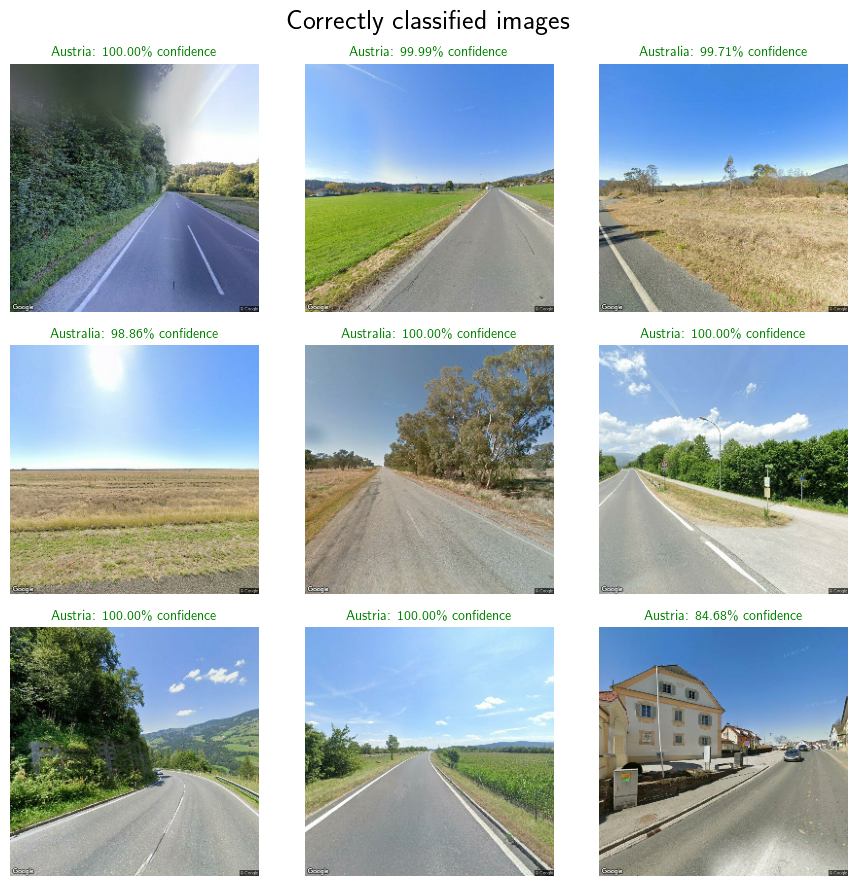

In [8]:
from data_visualization import plot_image_with_confidence

num_images = 9
    
fig = plt.figure(figsize=(9, num_images))
plt.suptitle("Correctly classified images", size = 20)
i = 1
for images, labels in config.val_ds.take(10):
    predictions = config.model.predict(images).reshape((32,))
    for image, prediction, label in zip(images, predictions, labels.numpy()):
        if np.round(prediction) == label:
            ax = plt.subplot(num_images//3, 3, i)
            plot_image_with_confidence(image, label, prediction)
            i += 1
        if i > num_images:
            break
    if i > num_images:
        break
plt.tight_layout()
plt.show()      

1/1 [==============================] - 0s 315ms/step


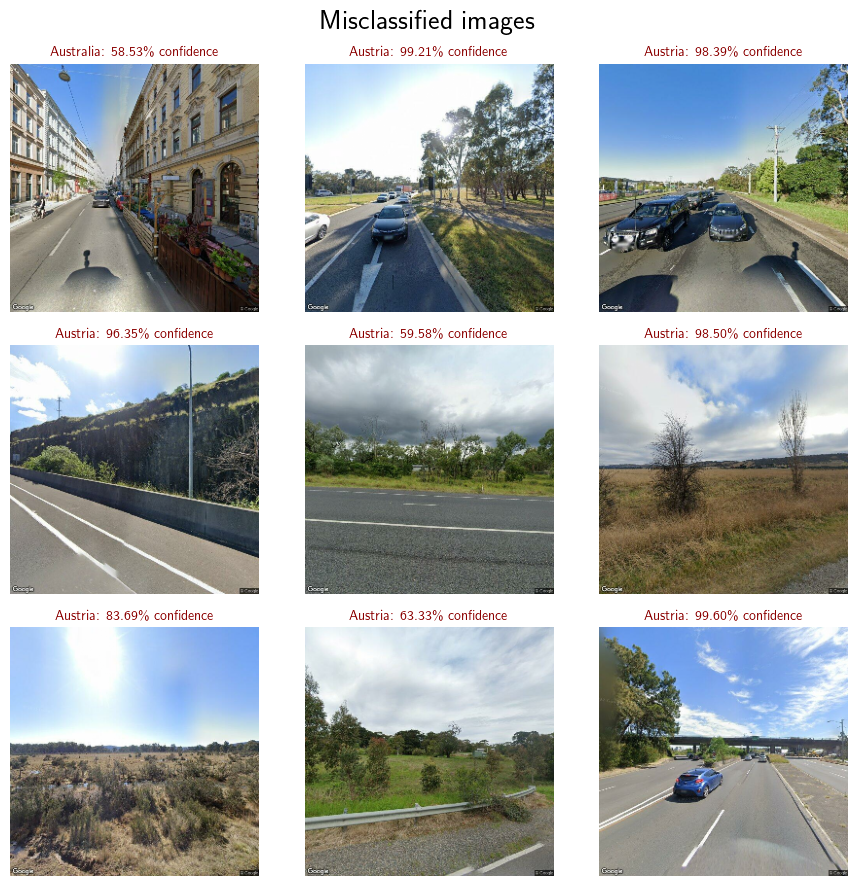

In [10]:
from data_visualization import plot_image_with_confidence

num_images = 9
    
fig = plt.figure(figsize=(9, num_images))
plt.suptitle("Misclassified images", size = 20)
i = 1
for images, labels in config.val_ds.take(10):
    predictions = config.model.predict(images).reshape((32,))
    for image, prediction, label in zip(images, predictions, labels.numpy()):
        if np.round(prediction) != label:
            ax = plt.subplot(num_images//3, 3, i)
            plot_image_with_confidence(image, label, prediction)
            i += 1
        if i > num_images:
            break
    if i > num_images:
        break
plt.tight_layout()
plt.show()      

1/1 [==============================] - 0s 447ms/step


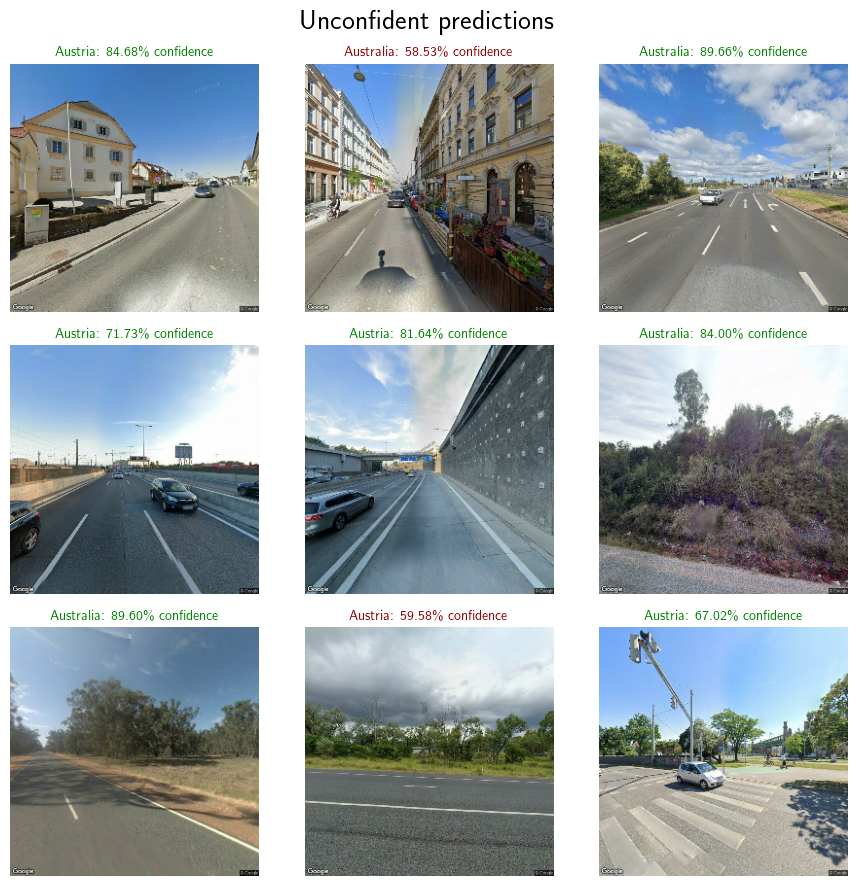

In [11]:
from data_visualization import plot_image_with_confidence

num_images = 9
    
fig = plt.figure(figsize=(9, num_images))
plt.suptitle("Unconfident predictions", size = 20)
i = 1
for images, labels in config.val_ds.take(10):
    predictions = config.model.predict(images).reshape((32,))
    for image, prediction, label in zip(images, predictions, labels.numpy()):
        if prediction > 0.1 and prediction < 0.9:
            ax = plt.subplot(num_images//3, 3, i)
            plot_image_with_confidence(image, label, prediction)
            i += 1
        if i > num_images:
            break
    if i > num_images:
        break
plt.tight_layout()
plt.show()      

### Pre-trained model on imagenet dataset

While I did not expect this pre-trained model to be useful in this setting,
I still wanted to try out what it might identify in my street view images.

In [2]:
from tensorflow.keras.applications.mobilenet_v2 import MobileNetV2

imagenet_model = MobileNetV2(
    alpha = 1.0,
    include_top = True,
    weights = 'imagenet',
    input_tensor = None,
    pooling = None,
    classes = 1000,
    classifier_activation = 'softmax'
)

optimizer = optimizers.Adam()
imagenet_model.compile(optimizer = optimizer, metrics = ['accuracy'])

In [4]:
predictions = imagenet_model.predict(config.val_ds224)

157/157 [==============================] - 184s 1s/step


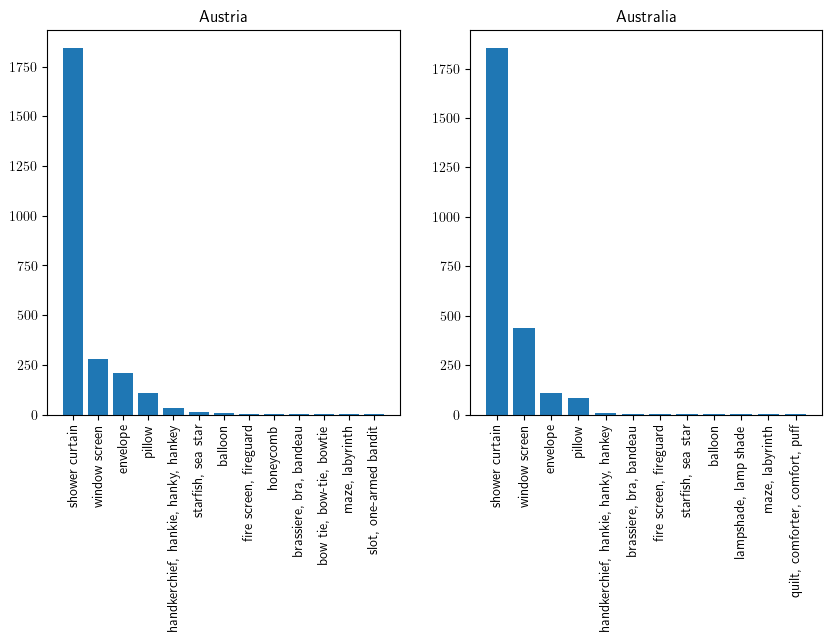

In [8]:
import ast
plt.figure(figsize = (10, 5))

with open('imagenet_classnames.txt') as f:
    class_names = ast.literal_eval(f.read())

labels = np.array([x for x in config.val_ds224.unbatch().map(lambda x,y: y)])

for i, country in enumerate(("Austria", "Australia")):
    top_predictions = np.argmax(predictions[labels == i], axis = 1)
    unique, counts = np.unique(top_predictions, return_counts=True)
    ax = plt.subplot(1, 2, i + 1)
    plt.bar([class_names[j] for j in unique[np.argsort(-counts)]], counts[np.argsort(-counts)])
    plt.xticks(rotation=90)
    plt.title(country)

plt.show()

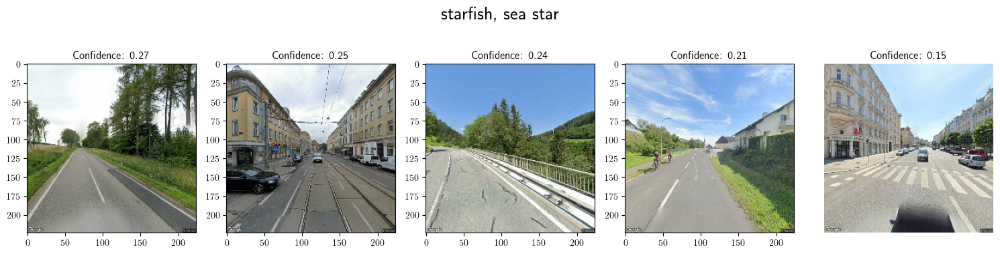

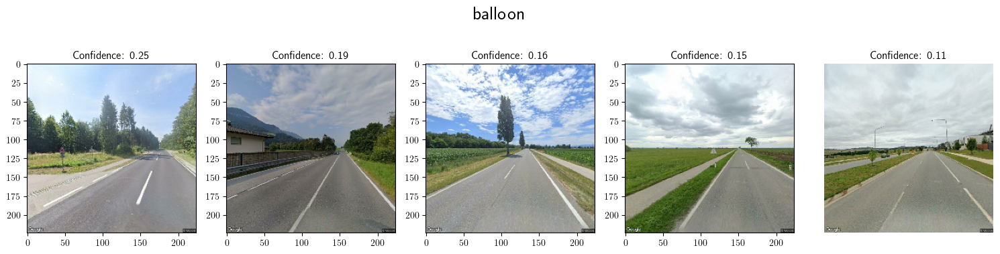

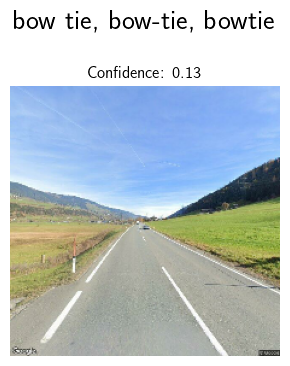

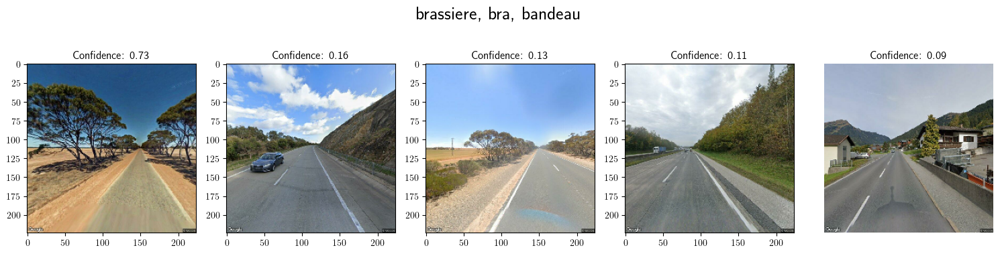

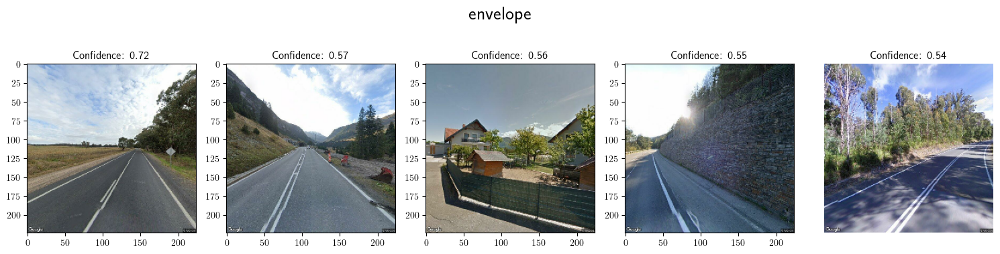

...

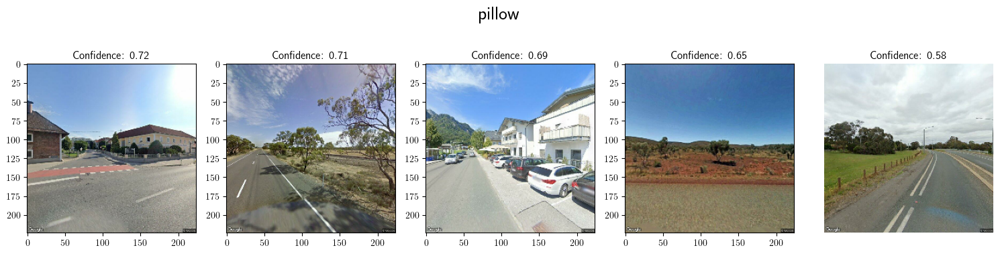

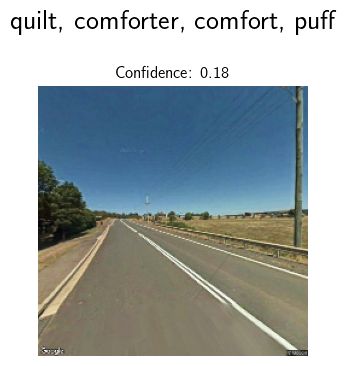

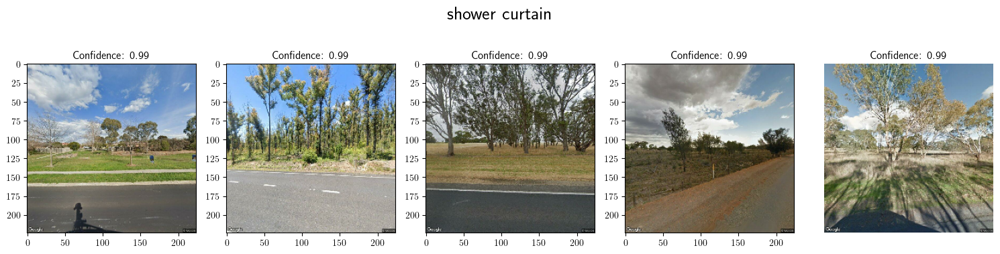

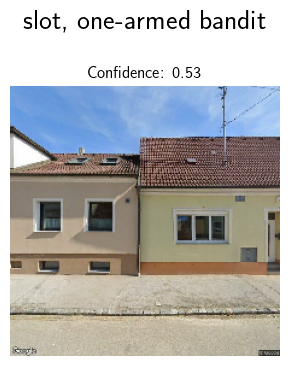

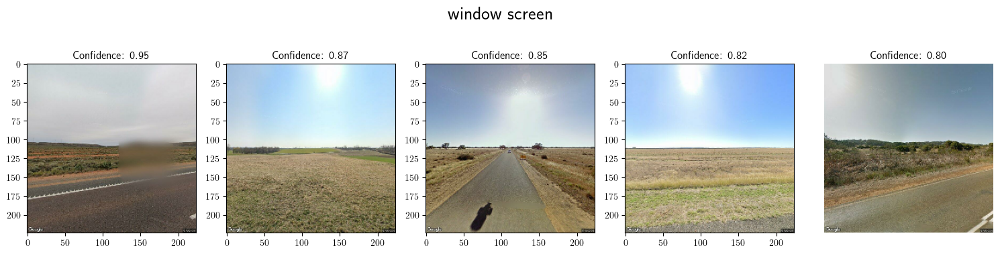

In [10]:
images = np.array([x for x in config.val_ds224.unbatch().map(lambda x,y: x)])

top_predictions = np.argmax(predictions, axis = 1)
unique, counts = np.unique(top_predictions, return_counts=True)
for label in unique:
    corresponding_images = images[top_predictions == label]
    corresponding_predictions = predictions[top_predictions == label][:,label]
    sorted_images_and_predictions = [(image, prediction) for prediction, image in sorted(zip(corresponding_predictions, corresponding_images), reverse = True)]
    fig = plt.figure(figsize=(3*min(5,len(corresponding_images)), 4))
    fig.suptitle(class_names[label], size = 20)
    for i, (image, prediction) in enumerate(sorted_images_and_predictions):
        ax = plt.subplot(1, min(5,len(sorted_images_and_predictions)), i + 1)
        plt.imshow(tf.cast(image, tf.uint8))
        plt.title(f"Confidence: {prediction:.2f}")
        if i == 4:
            break
    plt.axis("off")
    plt.tight_layout()
    plt.show()


## Multinomial Classification

## Adversarial Machine Learning via Signed Gradients

In [2]:
def adversarial_transformation(model, eps):

    def func(image, label):

        with tf.GradientTape() as g:
            g.watch(image)
            predicted_label = model(image)
            loss = losses.BinaryCrossentropy()(label, predicted_label)

            gradient = g.gradient(target = loss, sources = image)
            signed_gradient = tf.sign(gradient)
            adv_image = image + signed_gradient * eps

        return adv_image, label
    
    return func

In [5]:
eps_array = [0,1e-3,1e-2,1e-1,1e-0]


for eps in eps_array:
    print(f"{eps=}")
    if eps == 0:
        loss, accuracy = config.model.evaluate(config.val_ds)
    else:
        adv_ds = config.val_ds.map(adversarial_transformation(config.model, eps))
        loss, accuracy = config.model.evaluate(adv_ds)

eps=0
157/157 [==============================] - 74s 469ms/step - loss: 0.2390 - accuracy: 0.9342
eps=0.001
157/157 [==============================] - 513s 3s/step - loss: 0.4154 - accuracy: 0.8899
eps=0.01
157/157 [==============================] - 490s 3s/step - loss: 3.3498 - accuracy: 0.4523
eps=0.1
157/157 [==============================] - 500s 3s/step - loss: 10.6281 - accuracy: 0.2310
eps=1.0
157/157 [==============================] - 527s 3s/step - loss: 4.8793 - accuracy: 0.4360


1/1 [==============================] - 0s 415ms/step


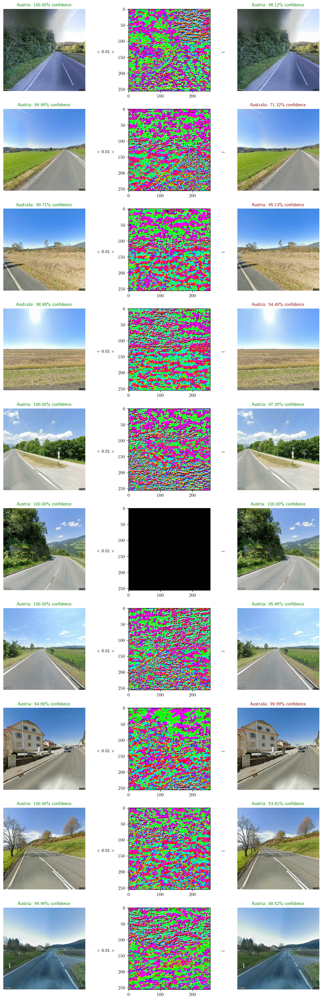

In [17]:
from data_visualization import plot_image_with_confidence, rescale_image

eps = 0.01

num_images = 10
fig = plt.figure(figsize = (10, num_images*3), constrained_layout=True)
subfigs = fig.subfigures(nrows=num_images, ncols=1)

class_labels = ["Austria", "Australia"]


for images, labels in config.val_ds.take(1):
    predictions = config.model.predict(images).reshape((32,))
    adv_images, _ = adversarial_transformation(config.model, eps)(images, labels)
    adv_predictions = config.model.predict(adv_images)
    i = 0
    for image, prediction, adv_image, adv_prediction, label in zip(images, predictions, adv_images, adv_predictions, labels):
        if round(prediction) == label and prediction != 1:
            axl, axm, axr = subfigs[i].subplots(nrows=1, ncols=3)

            plt.sca(axl)
            plot_image_with_confidence(image, label, prediction)

            plt.sca(axm)
            plt.imshow(rescale_image((adv_image - image)/eps))
            plt.text(-100, 128, f'+ {eps} ×', verticalalignment = 'top', rotation = 0)

            plt.sca(axr)
            plt.text(-50, 128, '=', verticalalignment = 'top', rotation = 0)
            plot_image_with_confidence(adv_image, label, adv_prediction[0])

            i += 1
            if i >= num_images:
                break
            
plt.show()


## Model Explainability via Integrated Gradients